# Data Mining on Email Data

**Required Readings:** 
* [Enron Emails](https://www.kaggle.com/wcukierski/enron-email-dataset) 
* Please download the Enron Email dataset from [here](https://www.cs.cmu.edu/~./enron/).

**Author : AKhil Pragallapati**

# Problem Statement:

One problem statement can be the detection of the spam email from the accquired email dataset.
The enron dataset given can be said as the most real dataset present on the internet, so the columns present are : 'file", "message".
Importance: This problem is important and interesting because spam email posees a significant threat to the efficiency and security of email communication. 
Detecting and filtering out spam emails can enhance the effectiveness of email communication
Therefore, developing an automated solution for identifying potential spam emails using data science techniques, such as anomaly detection or clustering, can be valuable in addressing this issue and enhancing the overall email communication experience.

# Data Collection/Processing: 

In [1]:
import pandas as pd

# The kaggle file link 
# https://drive.google.com/file/d/1mZUmxtwj51SR1xUEw0GghFh3tS5oXVfM/view?usp=sharing

# Load the Enron email dataset
emails_df = pd.read_csv("emails.csv") # Loaded the data https://www.kaggle.com/datasets/wcukierski/enron-email-dataset
emails_df

,file,message
0,allen-p/_sent_mail/1.,Message-ID: <18782981.1075855378110.JavaMail.e...
1,allen-p/_sent_mail/10.,Message-ID: <15464986.1075855378456.JavaMail.e...
2,allen-p/_sent_mail/100.,Message-ID: <24216240.1075855687451.JavaMail.e...
3,allen-p/_sent_mail/1000.,Message-ID: <13505866.1075863688222.JavaMail.e...
4,allen-p/_sent_mail/1001.,Message-ID: <30922949.1075863688243.JavaMail.e...
...,...,...
517396,zufferli-j/sent_items/95.,Message-ID: <26807948.1075842029936.JavaMail.e...
517397,zufferli-j/sent_items/96.,Message-ID: <25835861.1075842029959.JavaMail.e...
517398,zufferli-j/sent_items/97.,Message-ID: <28979867.1075842029988.JavaMail.e...
517399,zufferli-j/sent_items/98.,Message-ID: <22052556.1075842030013.JavaMail.e...


In [2]:
# This is the single data present in the message

print(emails_df['message'][0])

Message-ID: <18782981.1075855378110.JavaMail.evans@thyme>
Date: Mon, 14 May 2001 16:39:00 -0700 (PDT)
From: phillip.allen@enron.com
To: tim.belden@enron.com
Subject: 
Mime-Version: 1.0
Content-Type: text/plain; charset=us-ascii
Content-Transfer-Encoding: 7bit
X-From: Phillip K Allen
X-To: Tim Belden <Tim Belden/Enron@EnronXGate>
X-cc: 
X-bcc: 
X-Folder: \Phillip_Allen_Jan2002_1\Allen, Phillip K.\'Sent Mail
X-Origin: Allen-P
X-FileName: pallen (Non-Privileged).pst

Here is our forecast

 


In [ ]:
*** Do Not Run This Code ***

# As the dataset is having only 2 columns, "file" and "message", The entire data is in "message" Column.
# The Message Columns is then further seperated into different columns like
# "From" , "To", "Date", "Time", "Subject", "Message"

# The original dataset is huge so that when we try to run this code, the jupyter notebook gets stuck.
# I have used google collab with different sizes of the data, so that the computation works.
# This code below is after the merged dataset has been created, " merged_file_cleaned_email.csv"
# From now onwards I will be using the file for the case study.

import pandas as pd
import re

From_list = list()
to_list = list()

time_list = list()
date_list = list()
subject_list = list()
message_list = list()

for i in emails_df['message']:
    splitted = i.split('\n')
    From_list = From_list + [splitted[2][6:]]
    to_list =  to_list + [splitted[3][4:]]
    date_list = date_list + [re.findall(r'\d+ \w+ \d+', splitted[1])[0]]
    time_list = time_list + [re.findall(r'\d+:\d+:\d+', splitted[1])[0]]
    subject_list = subject_list + [splitted[4][9:]]
    message_list = message_list + [" ".join(splitted[16:])]
    
emails_df['From'] = From_list
emails_df['To'] = to_list
emails_df['Date'] = date_list
emails_df['Time'] = time_list
emails_df['Subject'] = subject_list
emails_df['Message'] = message_list



In [3]:
# This is the merged file with the dataframe which have the same data 
# Seperated into different columns which might be useful in the future analysis

# The file which I have created can be found below 
# https://drive.google.com/file/d/11aj9qCI1rjD5Rv7eH2E70fCZdOi4GCPe/view?usp=sharing

dropped_emails_df = pd.read_csv("merged_file_cleaned_email.csv")
dropped_emails_df

,From,To,Date,Time,Subject,Message
0,phillip.allen@enron.com,tim.belden@enron.com,14 May 2001,16:39:00,NaN,Here is our forecast
1,phillip.allen@enron.com,john.lavorato@enron.com,4 May 2001,13:51:00,Re:,Traveling to have a business meeting takes the...
2,phillip.allen@enron.com,leah.arsdall@enron.com,18 Oct 2000,03:00:00,Re: test,test successful. way to go!!!
3,phillip.allen@enron.com,randall.gay@enron.com,23 Oct 2000,06:13:00,NaN,"Randy, Can you send me a schedule of the sal..."
4,phillip.allen@enron.com,greg.piper@enron.com,31 Aug 2000,05:07:00,Re: Hello,Let's shoot for Tuesday at 11:45.
...,...,...,...,...,...,...
517396,john.zufferli@enron.com,kori.loibl@enron.com,28 Nov 2001,13:30:11,Trade with John Lavorato,This is a trade with OIL-SPEC-HEDGE-NG (John L...
517397,john.zufferli@enron.com,john.lavorato@enron.com,28 Nov 2001,12:47:48,Gas Hedges,Some of my position is with the Alberta Term b...
517398,john.zufferli@enron.com,dawn.doucet@enron.com,28 Nov 2001,07:20:00,RE: CONFIDENTIAL,"2 -----Original Message----- From: \tDoucet,..."
517399,john.zufferli@enron.com,jeanie.slone@enron.com,27 Nov 2001,11:52:45,Calgary Analyst/Associate,Analyst\t\t\t\t\tRank Stephane Brodeur\t\t\t1...


In [4]:
data = dropped_emails_df.dropna()
data

,From,To,Date,Time,Subject,Message
1,phillip.allen@enron.com,john.lavorato@enron.com,4 May 2001,13:51:00,Re:,Traveling to have a business meeting takes the...
2,phillip.allen@enron.com,leah.arsdall@enron.com,18 Oct 2000,03:00:00,Re: test,test successful. way to go!!!
4,phillip.allen@enron.com,greg.piper@enron.com,31 Aug 2000,05:07:00,Re: Hello,Let's shoot for Tuesday at 11:45.
5,phillip.allen@enron.com,greg.piper@enron.com,31 Aug 2000,04:17:00,Re: Hello,"Greg, How about either next Tuesday or Thurs..."
7,phillip.allen@enron.com,joyce.teixeira@enron.com,14 Jul 2000,06:59:00,Re: PRC review - phone calls,any morning between 10 and 11:30
...,...,...,...,...,...,...
517396,john.zufferli@enron.com,kori.loibl@enron.com,28 Nov 2001,13:30:11,Trade with John Lavorato,This is a trade with OIL-SPEC-HEDGE-NG (John L...
517397,john.zufferli@enron.com,john.lavorato@enron.com,28 Nov 2001,12:47:48,Gas Hedges,Some of my position is with the Alberta Term b...
517398,john.zufferli@enron.com,dawn.doucet@enron.com,28 Nov 2001,07:20:00,RE: CONFIDENTIAL,"2 -----Original Message----- From: \tDoucet,..."
517399,john.zufferli@enron.com,jeanie.slone@enron.com,27 Nov 2001,11:52:45,Calgary Analyst/Associate,Analyst\t\t\t\t\tRank Stephane Brodeur\t\t\t1...


# Data Exploration: Exploring the Email Dataset


In [5]:
import pandas as pd

# Load the dataset into a pandas dataframe
df = pd.read_csv('merged_file_cleaned_email.csv')

# Check the number of rows and columns in the dataframe
print('Shape of the dataframe:', df.shape)

# View the first 5 rows of the dataframe
print(df.head())

# Check for missing values in the dataframe
print('Number of missing values in each column:\n', df.isnull().sum())

# Check the data types of each column
print('Data types of each column:\n', df.dtypes)

# Check the number of unique values in each column
print('Number of unique values in each column:\n', df.nunique())

# View some statistics about the numeric columns in the dataframe
print('Summary statistics for numeric columns:\n', df.describe())


Shape of the dataframe: (517401, 6)
                      From                       To         Date      Time  \
0  phillip.allen@enron.com     tim.belden@enron.com  14 May 2001  16:39:00   
1  phillip.allen@enron.com  john.lavorato@enron.com   4 May 2001  13:51:00   
2  phillip.allen@enron.com   leah.arsdall@enron.com  18 Oct 2000  03:00:00   
3  phillip.allen@enron.com    randall.gay@enron.com  23 Oct 2000  06:13:00   
4  phillip.allen@enron.com     greg.piper@enron.com  31 Aug 2000  05:07:00   

     Subject                                            Message  
0        NaN                            Here is our forecast     
1        Re:  Traveling to have a business meeting takes the...  
2   Re: test                     test successful.  way to go!!!  
3        NaN  Randy,   Can you send me a schedule of the sal...  
4  Re: Hello                Let's shoot for Tuesday at 11:45.    
Number of missing values in each column:
 From           0
To           580
Date           0
Time  

In [6]:
import pandas as pd

to_from_data = data[['From', 'To']]
#print(to_from_data)
# Group by "from" and "to" columns, and get the count of occurrences
grouped = to_from_data.groupby(["From", "To"]).size().reset_index(name='Number of emails')
grouped


,From,To,Number of emails
0,'todd'.delahoussaye@enron.com,"derek.bailey@enron.com, jean.bell@enron.com, r...",5
1,'todd'.delahoussaye@enron.com,susan.bailey@enron.com,1
2,--migrated--bmishkin@ercot.com,mockmarket@ercot.com,1
3,--migrated--dodle@ercot.com,set@ercot.com,1
4,-nikole@excite.com,bill.williams@enron.com,8
...,...,...,...
102525,zulie.flores@enron.com,"marla.barnard@enron.com, cynthia.barrow@enron....",3
102526,zvo2z17d0@untappedmarkets.com,undisclosed-recipients@enron.com,1
102527,zwharton@dawray.com,martin.cuilla@enron.com,12
102528,zwharton@dawray.com,mcuilla@enron.com,15


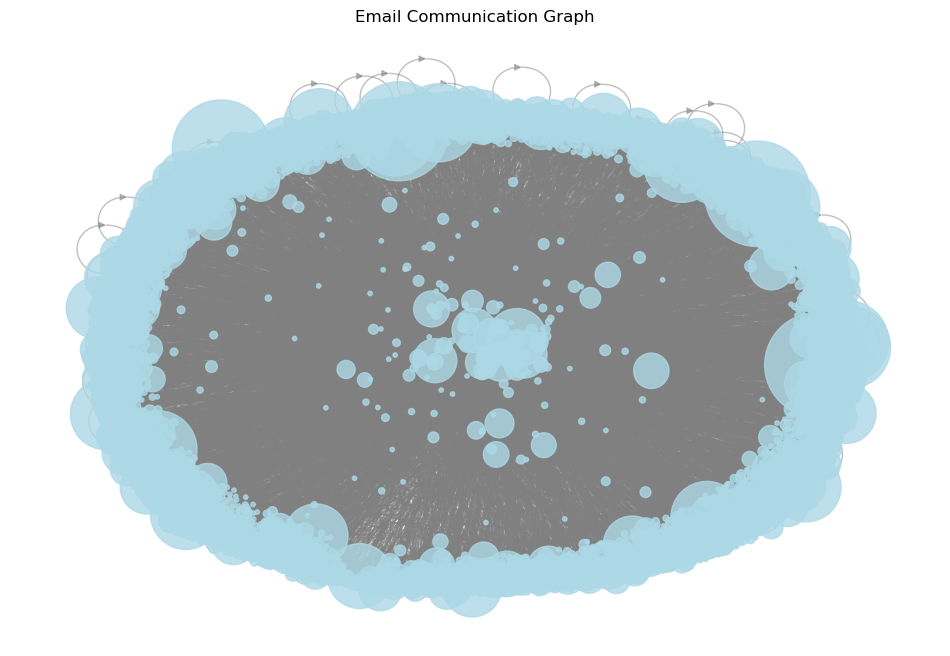

In [30]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# !!!!! Takes long time to run  !!!!!
# Can use the code in the cell below for checking purpose

# Load the email data into a pandas DataFrame
email_data = grouped  # Replace 'email_data.csv' with the actual filename or path of your dataset

# Create an empty directed graph
G = nx.DiGraph()

# Iterate through the rows of the email data and add nodes and edges to the graph
for _, row in email_data.iterrows():
    sender = row['From']
    receiver = row['To']
    weight = row['Number of emails']  # Replace 'Number of Emails' with the actual column name containing the count of emails
    
    # Add sender and receiver as nodes to the graph
    G.add_node(sender)
    G.add_node(receiver)
    
    # Add an edge between sender and receiver with weight as the number of emails
    G.add_edge(sender, receiver, weight=weight)

# Set node size based on the in-degree (total incoming emails) of each node
node_sizes = [G.in_degree(n, weight='weight')*10 for n in G.nodes()]

# Plot the graph
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G, seed=42)  # Use spring layout algorithm to position nodes
nx.draw_networkx_nodes(G, pos, node_color='lightblue', node_size=node_sizes, alpha=0.8)
nx.draw_networkx_edges(G, pos, edge_color='gray', alpha=0.5)
#nx.draw_networkx_labels(G, pos, font_size=12, font_color='black')
plt.title('Email Communication Graph')
plt.axis('off')
plt.show()

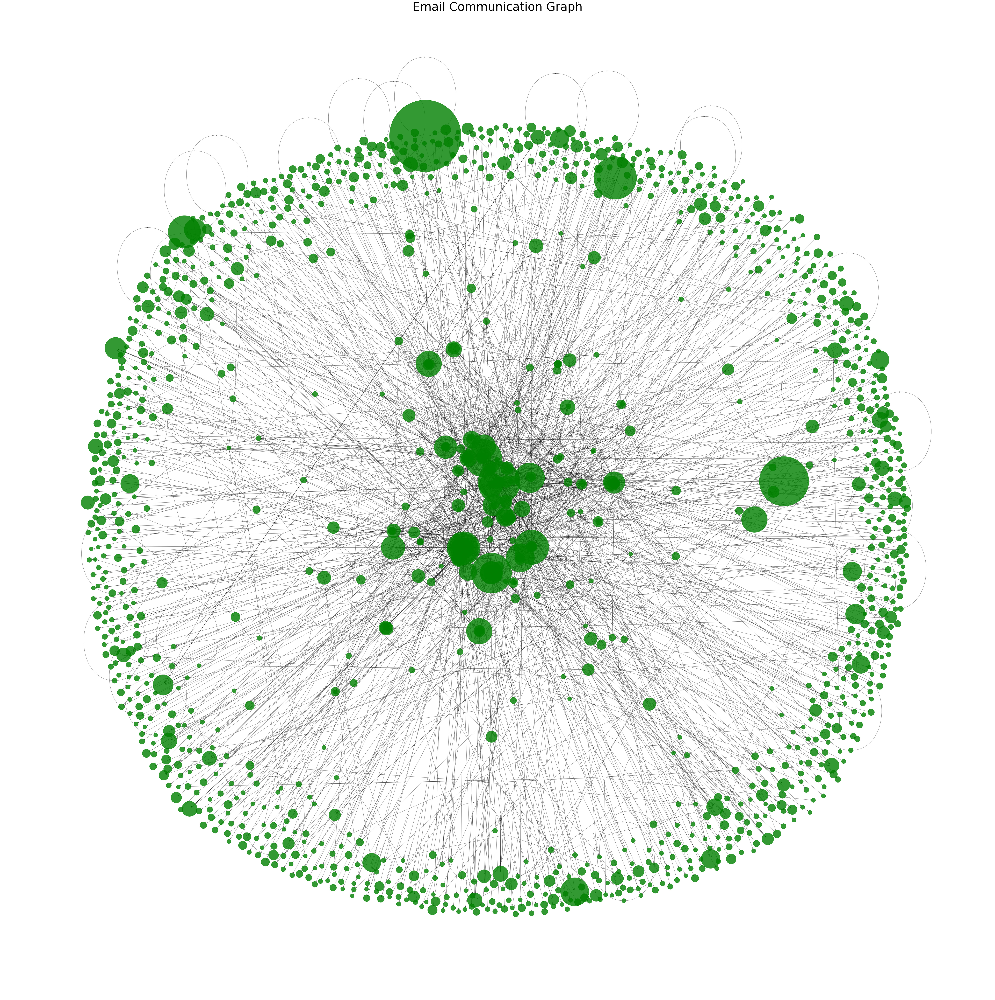

In [13]:
# sorting the values based on the desccending values of the emails sets.

# highest number of emails pairs first
df = grouped.sort_values(by='Number of emails', ascending=False)

import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the email data into a pandas DataFrame
email_data = df[:2000][:]  # Replace 'email_data.csv' with the actual filename or path of your dataset

# Create an empty directed graph
G = nx.DiGraph()

# Iterate through the rows of the email data and add nodes and edges to the graph
for _, row in email_data.iterrows():
    sender = row['From']
    receiver = row['To']
    weight = row['Number of emails']  # Replace 'Number of Emails' with the actual column name containing the count of emails
    
    # Add sender and receiver as nodes to the graph
    G.add_node(sender)
    G.add_node(receiver)
    
    # Add an edge between sender and receiver with weight as the number of emails
    G.add_edge(sender, receiver, weight=weight)

# Set node size based on the in-degree (total incoming emails) of each node
node_sizes = [G.in_degree(n, weight='weight')*10 for n in G.nodes()]

# Plot the graph
plt.figure(figsize=(75, 75))
pos = nx.spring_layout(G, seed=42)  # Use spring layout algorithm to position nodes
nx.draw_networkx_nodes(G, pos, node_color='green', node_size=node_sizes, alpha=0.8)
nx.draw_networkx_edges(G, pos, edge_color='black', alpha=0.5)
#nx.draw_networkx_labels(G, pos, font_size=12, font_color='black')
plt.title('Email Communication Graph', fontsize=50)
plt.axis('off')
plt.show()

The above graph Gives the the graph for highest 1000 lines of most frequent users, as the total data is huge which can be difficult to understand.

# The Solution: implement a data science solution to the problem you are trying to solve.

Briefly describe the idea of your solution to the problem in the following cell:

Write codes to implement the solution in python:

In [23]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary

# !!!!! Takes long time to run  !!!!!

import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np

# Extract relevant features for clustering
# For example, you can concatenate "From", "To", "Date", "Time", and "Subject" columns to create a combined feature
X = data["From"] + " " + data["To"] + " " + data["Date"] + " " + data["Time"] + " " + data["Subject"]

# Vectorize the features using a bag-of-words approach
vectorizer = CountVectorizer()
X_vec = vectorizer.fit_transform(X)

# Apply K-means clustering to group similar emails
n_clusters = 2  # Assuming there are two groups: spam and non-spam
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X_vec)

# Get the predicted cluster labels
cluster_labels = kmeans.labels_

# Calculate silhouette score to evaluate clustering performance
silhouette_avg = silhouette_score(X_vec, cluster_labels)

# Print the silhouette score
print("Silhouette Score: {:.2f}".format(silhouette_avg))

# Based on the silhouette score and domain knowledge, you can analyze the clusters to identify potential spam emails
# For example, if one cluster has significantly different characteristics compared to others, it could be a cluster of spam emails
# Further analysis and domain-specific knowledge may be needed to confirm the spam classification


Silhouette Score: 0.31


In [34]:
# Another model is Isolation Forest

import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.ensemble import IsolationForest

# Extract relevant features for anomaly detection

# Freature Creation
X = data["From"] + " " + data["To"] + " " + data["Date"] + " " + data["Time"] + " " + data["Subject"]

# Vectorized the features using a bag-of-words approach
vectorizer = CountVectorizer()
X_vec = vectorizer.fit_transform(X)

# Apply Isolation Forest for anomaly detection
clf = IsolationForest(contamination=0.05)  
clf.fit(X_vec)

# Get the predicted labels (-1 for anomalies, 1 for normal)
pred_labels = clf.predict(X_vec)

# Identify potential spam emails as anomalies
spam_indices = data[pred_labels == -1].index

# Print the potential spam emails
potential_spam_emails = data.loc[spam_indices, :]


# Summarize the results
total_emails = data.shape[0]
total_spam_emails = potential_spam_emails.shape[0]
spam_percentage = (total_spam_emails / total_emails) * 100

print("Total Emails: {}".format(total_emails))
print("Total Potential Spam Emails: {}".format(total_spam_emails))
print("Percentage of Potential Spam Emails: {:.2f}%".format(spam_percentage))
print("\nPotential Spam Emails:")

potential_spam_emails


517401
497792
Total Emails: 497792
Total Potential Spam Emails: 24890
Percentage of Potential Spam Emails: 5.00%

Potential Spam Emails:


,From,To,Date,Time,Subject,Message
12,phillip.allen@enron.com,keith.holst@enron.com,9 Oct 2000,07:16:00,Consolidated positions: Issues & To Do list,---------------------- Forwarded by Phillip K ...
13,phillip.allen@enron.com,keith.holst@enron.com,9 Oct 2000,07:00:00,Consolidated positions: Issues & To Do list,---------------------- Forwarded by Phillip K ...
283,phillip.allen@enron.com,"matthew.lenhart@enron.com, jay.reitmeyer@enron...",7 May 2001,02:28:00,Re: Western Wholesale Activities - Gas & Power...,Can you guys coordinate to make sure someone l...
299,phillip.allen@enron.com,ray.alvarez@enron.com,26 Apr 2001,01:34:00,Re: FERC's Prospective Mitigation and Monitori...,"Ray, Is there any detail on the gas cost pro..."
418,phillip.allen@enron.com,"christi.nicolay@enron.com, james.steffes@enron...",13 Dec 2000,07:04:00,"soe@enron.com, mary.hain@enron.com, pallen@enr...",X-bcc: X-Folder: \Phillip_Allen_Dec2000\Notes...
...,...,...,...,...,...,...
516605,andy.zipper@enron.com,lcannon@houston.rr.com,13 Dec 2001,08:44:08,RE: Letter of Recommendation,"I would be happy to, and yes you may use my name."
516650,andy.zipper@enron.com,john.griffith@enron.com,15 Nov 2001,09:50:09,FW: NEW WEATHER SWAPS ON THE INTERCONTINENTAL ...,We should be watching this... -----Original Me...
516727,andy.zipper@enron.com,bob.shults@enron.com,30 May 2001,11:52:20,RE: Broker Client for UK and European Gas and ...,good !
517208,john.zufferli@enron.com,nella.cappelletto@enron.com,21 Aug 2001,12:29:48,RE: Nat Gas Volumes/EOL Transactions,Good for me -----Original Message----- From:...


# Results:
